## Final Project

#### In this file I explore the data and prepare it to work on the applicable machine learning models.

1. I download the libraries that I will use

In [1]:
!pip install scikit-learn

In [2]:
import sys
!{sys.executable} -m pip install -U ydata-profiling[notebook]
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


In [3]:
import pandas as pd
import seaborn as sns
import numpy as np
import scipy.stats as st
from IPython.display import display
from pathlib import Path
from ipywidgets import widgets
from ydata_profiling import ProfileReport

2. Data exploration

In [4]:
data = pd.read_csv('../Data/raw/LifeExpectancyData.csv')
display(data)

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [5]:
data.columns.values

array(['Country', 'Year', 'Status', 'Life expectancy ', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure',
       'Hepatitis B', 'Measles ', ' BMI ', 'under-five deaths ', 'Polio',
       'Total expenditure', 'Diphtheria ', ' HIV/AIDS', 'GDP',
       'Population', ' thinness  1-19 years', ' thinness 5-9 years',
       'Income composition of resources', 'Schooling'], dtype=object)

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   object 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   object 
 3   Life expectancy                  2928 non-null   float64
 4   Adult Mortality                  2928 non-null   float64
 5   infant deaths                    2938 non-null   int64  
 6   Alcohol                          2744 non-null   float64
 7   percentage expenditure           2938 non-null   float64
 8   Hepatitis B                      2385 non-null   float64
 9   Measles                          2938 non-null   int64  
 10   BMI                             2904 non-null   float64
 11  under-five deaths                2938 non-null   int64  
 12  Polio               

In [7]:
data['Status'].unique()

array(['Developing', 'Developed'], dtype=object)

3. After a first exploration, it is observed that it is necessary to homogenize the titles of the columns, and assign values ​​of 0 and 1 to the categories of the status variable. To do this, a function is used.

In [8]:
def data_clean(df):
    df.columns = df.columns.str.lower()
    df.columns = [i.replace(' ', '_') for i in df.columns]
    df.columns = [i.replace('/', '_') for i in df.columns]
    df.columns = [i.replace('-', '_') for i in df.columns]
    df.columns = [column.strip('_') for column in df.columns]
    df['status'].replace(['Developed', 'Developing'], [0, 1], inplace=True)
    return df
data = data_clean(data)
display(data)

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,2015,1,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,1,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,1,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,1,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,1,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,1,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,1,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,1,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,1,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


4. Null data are analyzed, and given the presence of a significant number of NaN in Hepatitis B, GDP and Population variables, mainly, each variable is analyzed in greater detail using a profile report in order to define the best way to treat NaNs.

In [9]:
nulls_df = pd.DataFrame(round(data.isna().sum()/len(data),4)*100)
nulls_df = nulls_df.reset_index()
nulls_df.columns = ['header_name', 'percent_nulls']
display(nulls_df)

,header_name,percent_nulls
0,country,0.00
1,year,0.00
2,status,0.00
3,life_expectancy,0.34
4,adult_mortality,0.34
5,infant_deaths,0.00
6,alcohol,6.60
7,percentage_expenditure,0.00
8,hepatitis_b,18.82
9,measles,0.00


In [10]:
profile = ProfileReport(data, title="Pandas Profiling Report", html={'style':{'full_width':True}})

In [11]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
profile.to_file("../Sliders/life_expentancy_explor.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

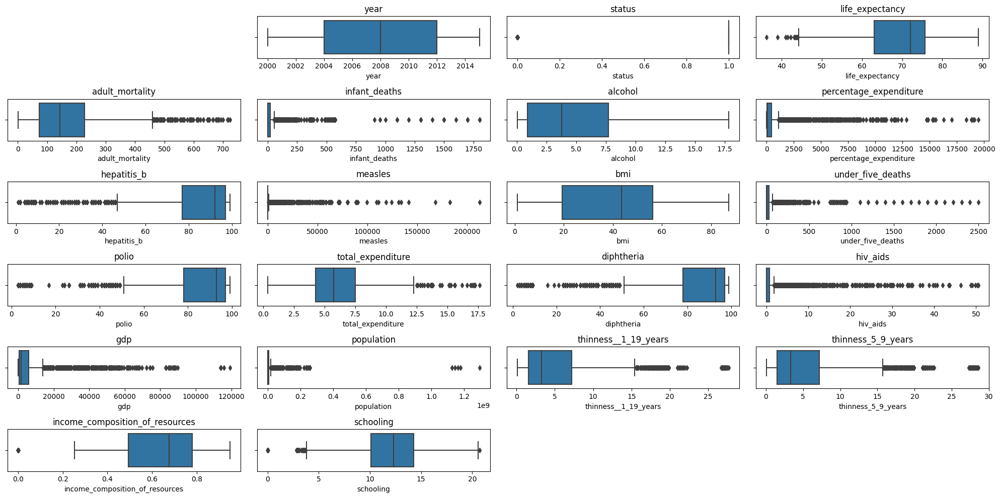

In [13]:
import matplotlib.pyplot as plt
%matplotlib inline

def create_boxplot(data):
    plt.figure(figsize=(20, 10))  
    cols = data.select_dtypes(exclude=['object']).columns.tolist()
    for col in cols:
        plt.subplot(6, 4, data.columns.get_loc(col) + 1)  # Add +1 to the index
        sns.boxplot(x=col, data=data)
        plt.title(col)
    plt.tight_layout()
    plt.show()
create_boxplot(data)

When analyzing the data it is considered important to carry out the following:

1. Process the NaN data.
2. Define if the outliers should be removed.
3. Transform variable 'country' to eliminate high cardinality
4. Define if variable 'year' is relevant or not for the analysis. For which we will carry out an ANOVA test.

From this, three databases will be generated with which the regression models will be made, with the following characteristics:

data1
1. NaNs are removed.
2. Outliers are removed.
3. ANOVA test to define if 'year' is used or not.
4. Countries are transformed with encoder function.

data2
1. NaNs are treated with KNN.
2. Outliers are removed.
3. Countries are transformed into an ordinal categorical variable.

data3
1. NaNs are removed.
2. Outliers are NOT removed.
3. Countries are transformed into an ordinal categorical variable.

### Process to generate data1

1. NaNs are removed.

In [14]:
data.dropna(axis=0, inplace=True) 
data

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,2015,1,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,1,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,1,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,1,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,1,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,1,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,1,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,1,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,1,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


2. Outliers are removed.

In [15]:
def remove_outliers(data, thr=1.5):
    cols = data.select_dtypes(exclude=['object']).columns.tolist()
    for col in cols:
        mean = data[col].mean()
        std = data[col].std()
        lower_bound = mean - (std * thr)
        upper_bound = mean + (std * thr)
        data1 = data[(data[col] >= lower_bound) & (data[col] <= upper_bound)] 
    return data1

data1 = remove_outliers(data)
data1

,country,year,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,2015,1,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,1,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,1,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,1,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,1,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,1,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,1,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,1,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,1,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [16]:
nulls_df = pd.DataFrame(round(data1.isna().sum()/len(data1),4)*100)
nulls_df = nulls_df.reset_index()
nulls_df.columns = ['header_name', 'percent_nulls']
display(nulls_df)

,header_name,percent_nulls
0,country,0.0
1,year,0.0
2,status,0.0
3,life_expectancy,0.0
4,adult_mortality,0.0
5,infant_deaths,0.0
6,alcohol,0.0
7,percentage_expenditure,0.0
8,hepatitis_b,0.0
9,measles,0.0


3. ANOVA test to define if 'year' is used or not.

In [17]:
life_expectancy_by_year = data1.groupby(['year']).agg({"life_expectancy":np.nanmean})
display(life_expectancy_by_year)

,life_expectancy
year,
2000,70.769643
2001,70.971186
2002,69.533803
2003,69.382716
2004,69.157778
2005,69.064286
2006,69.419417
2007,69.435238
2008,69.383486


In [18]:
st.f_oneway(data1[data1['year']==2000]['life_expectancy'],
           data1[data1['year']==2001]['life_expectancy'],
           data1[data1['year']==2002]['life_expectancy'],
           data1[data1['year']==2003]['life_expectancy'],
           data1[data1['year']==2004]['life_expectancy'],
           data1[data1['year']==2005]['life_expectancy'],
           data1[data1['year']==2006]['life_expectancy'],
           data1[data1['year']==2007]['life_expectancy'],
           data1[data1['year']==2008]['life_expectancy'],
           data1[data1['year']==2009]['life_expectancy'],
           data1[data1['year']==2010]['life_expectancy'],
           data1[data1['year']==2011]['life_expectancy'],
           data1[data1['year']==2012]['life_expectancy'],
           data1[data1['year']==2013]['life_expectancy'],
           data1[data1['year']==2014]['life_expectancy'],
           data1[data1['year']==2015]['life_expectancy'])

F_onewayResult(statistic=0.33378528242636996, pvalue=0.9919493220628887)

H0 for ANOVA is that the means of 'life_expectancy' for all the years are the same.

H1 is that they are not the same.

With the result of the ANOVA test we can see that pvalue> 0.05, so we accept H0. Since the means are the same, the year variable would not be relevant, so we can not include it in the machine learning models that we will test.

4. Countries are transformed with encoder function.

In [19]:
data1['country'].unique()

array(['Afghanistan', 'Albania', 'Algeria', 'Angola', 'Argentina',
       'Armenia', 'Austria', 'Azerbaijan', 'Bangladesh', 'Belarus',
       'Belgium', 'Belize', 'Benin', 'Bhutan', 'Bosnia and Herzegovina',
       'Botswana', 'Brazil', 'Bulgaria', 'Burundi', 'Cabo Verde',
       'Cambodia', 'Cameroon', 'Canada', 'Chile', 'China', 'Colombia',
       'Comoros', 'Costa Rica', 'Croatia', 'Cyprus', 'Dominican Republic',
       'Ecuador', 'El Salvador', 'Equatorial Guinea', 'Estonia',
       'Ethiopia', 'Fiji', 'France', 'Gabon', 'Georgia', 'Germany',
       'Ghana', 'Greece', 'Guatemala', 'Guinea', 'Guinea-Bissau',
       'Guyana', 'Haiti', 'Honduras', 'India', 'Indonesia', 'Iraq',
       'Israel', 'Italy', 'Jamaica', 'Jordan', 'Kazakhstan', 'Kenya',
       'Kiribati', 'Latvia', 'Lebanon', 'Lesotho', 'Liberia', 'Lithuania',
       'Luxembourg', 'Madagascar', 'Malawi', 'Malaysia', 'Maldives',
       'Mali', 'Malta', 'Mauritania', 'Mauritius', 'Mexico', 'Mongolia',
       'Montenegro', 'Moro

In [20]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
data1['country'] = label_encoder.fit_transform(data1['country']).astype('int32')

/var/folders/xk/7bvp3vv975g8gc_ykn02znwm0000gn/T/ipykernel_78261/2147121691.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data1['country'] = label_encoder.fit_transform(data1['country']).astype('int32')


In [21]:
data1 = data1.drop(columns=['year'])
data1

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,0,1,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,0,1,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,0,1,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,0,1,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,0,1,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,122,1,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,122,1,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,122,1,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,122,1,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [22]:
data1.to_csv('../Data/cleaned/data1.csv', index=False)

### Process to generate data2

We import the original database again to give it a new treatment. Since we saw in the database data1 that the variable year is not relevant, we will eliminate it from the beginning, for which we add this step in the function.

In [23]:
data = pd.read_csv('../Data/raw/LifeExpectancyData.csv')
display(data)

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [24]:
def data_clean(df):
    df.columns = df.columns.str.lower()
    df.columns = [i.replace(' ', '_') for i in df.columns]
    df.columns = [i.replace('/', '_') for i in df.columns]
    df.columns = [i.replace('-', '_') for i in df.columns]
    df.columns = [column.strip('_') for column in df.columns]
    df['status'].replace(['Developed', 'Developing'], [0, 1], inplace=True)
    df = df.drop('year', axis=1)
    return df
data = data_clean(data)
display(data)

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,1,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,1,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,1,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,1,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,1,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,1,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,1,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,1,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,1,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [25]:
data['country'].unique()

array(['Afghanistan', 'Albania', 'Algeria', 'Angola',
       'Antigua and Barbuda', 'Argentina', 'Armenia', 'Australia',
       'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh',
       'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bhutan',
       'Bolivia (Plurinational State of)', 'Bosnia and Herzegovina',
       'Botswana', 'Brazil', 'Brunei Darussalam', 'Bulgaria',
       'Burkina Faso', 'Burundi', "Côte d'Ivoire", 'Cabo Verde',
       'Cambodia', 'Cameroon', 'Canada', 'Central African Republic',
       'Chad', 'Chile', 'China', 'Colombia', 'Comoros', 'Congo',
       'Cook Islands', 'Costa Rica', 'Croatia', 'Cuba', 'Cyprus',
       'Czechia', "Democratic People's Republic of Korea",
       'Democratic Republic of the Congo', 'Denmark', 'Djibouti',
       'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt',
       'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia',
       'Ethiopia', 'Fiji', 'Finland', 'France', 'Gabon', 'Gambia',
       'Georgia', 'Germany'

1. Countries are transformed into an ordinal categorical variable. 

To assign the value for each country, the average of the 'life_expectancy' variable is grouped by country and the highest value of the number of countries with values ​​for the country with the highest average is assigned, and from there the order is descending. Null values ​​are assigned a value of 0.

In [26]:
life_expectancy_by_country = data.groupby(['country']).agg({"life_expectancy": np.nanmean})
life_expectancy_by_country = life_expectancy_by_country.sort_values(by='life_expectancy', ascending=False)
display(life_expectancy_by_country)

,life_expectancy
country,
Japan,82.53750
Sweden,82.51875
Iceland,82.44375
Switzerland,82.33125
France,82.21875
...,...
Niue,NaN
Palau,NaN
Saint Kitts and Nevis,NaN


In [27]:
life_expectancy_by_country['life_expectancy'].fillna(0, inplace=True)
result_list = list(zip(life_expectancy_by_country.index, life_expectancy_by_country['life_expectancy']))
result_list

[('Japan', 82.5375),
 ('Sweden', 82.51875),
 ('Iceland', 82.44375),
 ('Switzerland', 82.33125),
 ('France', 82.21875),
 ('Italy', 82.1875),
 ('Spain', 82.06875),
 ('Australia', 81.8125),
 ('Norway', 81.79375),
 ('Canada', 81.6875),
 ('Austria', 81.48125),
 ('Singapore', 81.475),
 ('New Zealand', 81.3375),
 ('Israel', 81.3),
 ('Greece', 81.21875),
 ('Germany', 81.175),
 ('Netherlands', 81.13125),
 ('United Kingdom of Great Britain and Northern Ireland', 80.79375),
 ('Luxembourg', 80.78125),
 ('Finland', 80.7125),
 ('Belgium', 80.68125),
 ('Republic of Korea', 80.4875),
 ('Malta', 80.3625),
 ('Ireland', 80.15),
 ('Portugal', 79.99375),
 ('Slovenia', 79.73125),
 ('Cyprus', 79.675),
 ('Chile', 79.45),
 ('Denmark', 79.25625),
 ('Costa Rica', 78.59375),
 ('United States of America', 78.0625),
 ('Cuba', 77.975),
 ('Qatar', 77.03125),
 ('Czechia', 76.76875),
 ('Panama', 76.4875),
 ('Brunei Darussalam', 76.4875),
 ('Croatia', 76.11875),
 ('Uruguay', 76.075),
 ('Bosnia and Herzegovina', 75.96875

In [28]:
mapping_dict = {'Japan': 183.0, 'Sweden': 182.0, 'Iceland': 181.0, 'Switzerland': 180.0, 'France': 179.0, 'Italy': 178.0, 'Spain': 177.0, 'Australia': 176.0, 'Norway': 175.0, 'Canada': 174.0, 'Austria': 173.0, 'Singapore': 172.0, 'New Zealand': 171.0, 'Israel': 170.0, 'Greece': 169.0, 'Germany': 168.0, 'Netherlands': 167.0, 'United Kingdom of Great Britain and Northern Ireland': 166.0, 'Luxembourg': 165.0, 'Finland': 164.0, 'Belgium': 163.0, 'Republic of Korea': 162.0, 'Malta': 161.0, 'Ireland': 160.0, 'Portugal': 159.0, 'Slovenia': 158.0, 'Cyprus': 157.0, 'Chile': 156.0, 'Denmark': 155.0, 'Costa Rica': 154.0, 'United States of America': 153.0, 'Cuba': 152.0, 'Qatar': 151.0, 'Czechia': 150.0, 'Panama': 149.0, 'Brunei Darussalam': 148.0, 'Croatia': 147.0, 'Uruguay': 146.0, 'Bosnia and Herzegovina': 145.0, 'Bahrain': 144.0, 'Mexico': 143.0, 'United Arab Emirates': 142.0, 'Poland': 141.0, 'Maldives': 140.0, 'Albania': 139.0, 'Argentina': 138.0, 'Antigua and Barbuda': 137.0, 'Estonia': 136.0, 'Oman': 135.0, 'Viet Nam': 134.0, 'Slovakia': 133.0, 'Ecuador': 132.0, 'Montenegro': 131.0, 'Barbados': 130.0, 'Tunisia': 129.0, 'Jamaica': 128.0, 'Bahamas': 127.0, 'China': 126.0, 'Lebanon': 125.0, 'The former Yugoslav republic of Macedonia': 124.0, 'Romania': 123.0, 'Serbia': 122.0, 'Turkey': 121.0, 'Iran (Islamic Republic of)': 120.0, 'Kuwait': 119.0, 'Hungary': 118.0, 'Malaysia': 117.0, 'Latvia': 116.0, 'Peru': 115.0, 'Samoa': 114.0, 'Algeria': 113.0, 'Saint Lucia': 112.0, 'Georgia': 111.0, 'Saint Vincent and the Grenadines': 110.0, 'Saudi Arabia': 109.0, 'Nicaragua': 108.0, 'Sri Lanka': 107.0, 'Armenia': 106.0, 'Venezuela (Bolivarian Republic of)': 105.0, 'Brazil': 104.0, 'Grenada': 103.0, 'Colombia': 102.0, 'Paraguay': 101.0, 'Thailand': 100.0, 'Honduras': 99.0, 'Jordan': 98.0, 'Bulgaria': 97.0, 'Lithuania': 96.0, 'Mauritius': 95.0, 'Tonga': 94.0, 'Cabo Verde': 93.0, 'Libya': 92.0, 'Seychelles': 91.0, 'Dominican Republic': 90.0, 'Morocco': 89.0, 'El Salvador': 88.0, 'Guatemala': 87.0, 'Egypt': 86.0, 'Vanuatu': 85.0, 'Trinidad and Tobago': 84.0, 'Syrian Arab Republic': 83.0, 'Azerbaijan': 82.0, 'Iraq': 81.0, 'Suriname': 80.0, 'Republic of Moldova': 79.0, 'Ukraine': 78.0, 'Belarus': 77.0, 'Bangladesh': 76.0, 'Belize': 75.0, "Democratic People's Republic of Korea": 74.0, 'Kyrgyzstan': 73.0, 'Fiji': 72.0, 'Micronesia (Federated States of)': 71.0, 'Uzbekistan': 70.0, 'Russian Federation': 69.0, 'Solomon Islands': 68.0, 'Bolivia (Plurinational State of)': 67.0, 'Philippines': 66.0, 'Indonesia': 65.0, 'Kazakhstan': 64.0, 'Tajikistan': 63.0, 'Nepal': 62.0, 'Bhutan': 61.0, 'Mongolia': 60.0, 'Guyana': 59.0, 'India': 58.0, 'Sao Tome and Principe': 57.0, 'Kiribati': 56.0, 'Timor-Leste': 55.0, 'Turkmenistan': 54.0, 'Pakistan': 53.0, 'Cambodia': 52.0, 'Myanmar': 51.0, 'Yemen': 50.0, 'Mauritania': 49.0, 'Madagascar': 48.0, 'Senegal': 47.0, "Lao People's Democratic Republic": 46.0, 'Gabon': 45.0, 'Sudan': 44.0, 'Papua New Guinea': 43.0, 'Comoros': 42.0, 'Ghana': 41.0, 'Djibouti': 40.0, 'Eritrea': 39.0, 'Namibia': 38.0, 'Haiti': 37.0, 'Gambia': 36.0, 'Rwanda': 35.0, 'Ethiopia': 34.0, 'Congo': 33.0, 'Afghanistan': 32.0, 'Benin': 31.0, 'Liberia': 30.0, 'South Africa': 29.0, 'Kenya': 28.0, 'Niger': 27.0, 'Togo': 26.0, 'Botswana': 25.0, 'Guinea': 24.0, 'United Republic of Tanzania': 23.0, 'Uganda': 22.0, 'Democratic Republic of the Congo': 21.0, 'Burkina Faso': 20.0, 'Burundi': 19.0, 'Guinea-Bissau': 18.0, 'Equatorial Guinea': 17.0, 'Mali': 16.0, 'Cameroon': 15.0, 'Zambia': 14.0, 'South Sudan': 13.0, 'Mozambique': 12.0, 'Somalia': 11.0, 'Nigeria': 10.0, 'Swaziland': 9.0, 'Zimbabwe': 8.0, "Côte d'Ivoire": 7.0, 'Chad': 6.0, 'Malawi': 5.0, 'Angola': 4.0, 'Lesotho': 3.0, 'Central African Republic': 2.0, 'Sierra Leone': 1.0, 'Cook Islands': 0.0, 'Dominica': 0.0, 'Marshall Islands': 0.0, 'Monaco': 0.0, 'Nauru': 0.0, 'Niue': 0.0, 'Palau': 0.0, 'Saint Kitts and Nevis': 0.0, 'San Marino': 0.0, 'Tuvalu': 0.0}
data['country'] = data['country'].replace(mapping_dict)
data

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,32.0,1,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,32.0,1,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,32.0,1,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,32.0,1,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,32.0,1,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,8.0,1,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,8.0,1,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,8.0,1,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,8.0,1,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


2. NaNs are treated with KNN.

In [29]:
from sklearn.impute import KNNImputer
data_knn = KNNImputer()
data_imputed_knn = data_knn.fit_transform(data)
data_knn = pd.DataFrame(data_imputed_knn, columns=data.columns)
data_knn

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,32.0,1.0,65.0,263.0,62.0,0.01,71.279624,65.0,1154.0,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,32.0,1.0,59.9,271.0,64.0,0.01,73.523582,62.0,492.0,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,32.0,1.0,59.9,268.0,66.0,0.01,73.219243,64.0,430.0,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,32.0,1.0,59.5,272.0,69.0,0.01,78.184215,67.0,2787.0,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,32.0,1.0,59.2,275.0,71.0,0.01,7.097109,68.0,3013.0,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,8.0,1.0,44.3,723.0,27.0,4.36,0.000000,68.0,31.0,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,8.0,1.0,44.5,715.0,26.0,4.06,0.000000,7.0,998.0,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,8.0,1.0,44.8,73.0,25.0,4.43,0.000000,73.0,304.0,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,8.0,1.0,45.3,686.0,25.0,1.72,0.000000,76.0,529.0,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [30]:
data_knn.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2938 entries, 0 to 2937
Data columns (total 21 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   country                          2938 non-null   float64
 1   status                           2938 non-null   float64
 2   life_expectancy                  2938 non-null   float64
 3   adult_mortality                  2938 non-null   float64
 4   infant_deaths                    2938 non-null   float64
 5   alcohol                          2938 non-null   float64
 6   percentage_expenditure           2938 non-null   float64
 7   hepatitis_b                      2938 non-null   float64
 8   measles                          2938 non-null   float64
 9   bmi                              2938 non-null   float64
 10  under_five_deaths                2938 non-null   float64
 11  polio                            2938 non-null   float64
 12  total_expenditure   

In [31]:
nulls_df = pd.DataFrame(round(data_knn.isna().sum()/len(data_knn),4)*100)
nulls_df = nulls_df.reset_index()
nulls_df.columns = ['header_name', 'percent_nulls']
display(nulls_df)

,header_name,percent_nulls
0,country,0.0
1,status,0.0
2,life_expectancy,0.0
3,adult_mortality,0.0
4,infant_deaths,0.0
5,alcohol,0.0
6,percentage_expenditure,0.0
7,hepatitis_b,0.0
8,measles,0.0
9,bmi,0.0


In [32]:
from scipy.stats import skew, kurtosis
color_pal = sns.color_palette(palette='muted')
null_features = ['life_expectancy', 'adult_mortality',
       'alcohol', 'hepatitis_b', 'bmi', 'polio',
       'total_expenditure', 'diphtheria', 'gdp', 'population',
       'thinness__1_19_years', 'thinness_5_9_years',
       'income_composition_of_resources', 'schooling']
def draw_histplot():
    f, axes = plt.subplots(nrows=len(null_features), ncols=2, figsize=(24, len(null_features)*6))
    for x in range(0, len(null_features)):
        sns.histplot(data, x=null_features[x], kde=True, ax=axes[x, 0], color=color_pal[0])
        sns.histplot(data_knn, x=null_features[x], kde=True, ax=axes[x, 1], color=color_pal[1])
    for i, ax in enumerate(axes.reshape(-1)):
        if i % 2 == 0:
            selected_title = 'Before Imputation'
            selected_data = data[null_features[int(i/2)]].dropna()
        elif i % 2 == 1:
            selected_title = 'KNN Imputation'
            selected_data = data_knn[null_features[int(i/2)]]
        ax.set_title(selected_title)
        ax.text(x=0.97, y=0.97, transform=ax.transAxes, s="Skewness: %f" % skew(selected_data),\
            fontsize=9, verticalalignment='top', horizontalalignment='right')
        ax.text(x=0.97, y=0.91, transform=ax.transAxes, s="Kurtosis: %f" % kurtosis(selected_data),\
            fontsize=9, verticalalignment='top', horizontalalignment='right')

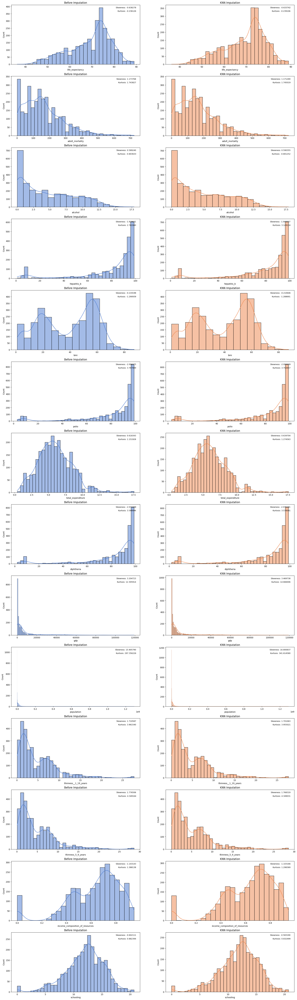

In [33]:
draw_histplot()

3. Outliers are removed.

In [34]:
data_knn

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,32.0,1.0,65.0,263.0,62.0,0.01,71.279624,65.0,1154.0,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,32.0,1.0,59.9,271.0,64.0,0.01,73.523582,62.0,492.0,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,32.0,1.0,59.9,268.0,66.0,0.01,73.219243,64.0,430.0,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,32.0,1.0,59.5,272.0,69.0,0.01,78.184215,67.0,2787.0,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,32.0,1.0,59.2,275.0,71.0,0.01,7.097109,68.0,3013.0,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,8.0,1.0,44.3,723.0,27.0,4.36,0.000000,68.0,31.0,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,8.0,1.0,44.5,715.0,26.0,4.06,0.000000,7.0,998.0,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,8.0,1.0,44.8,73.0,25.0,4.43,0.000000,73.0,304.0,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,8.0,1.0,45.3,686.0,25.0,1.72,0.000000,76.0,529.0,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [35]:
def remove_outliers(data_knn, thr=1.5):
    for col in data_knn:
        mean = data_knn[col].mean()
        std = data_knn[col].std()
        lower_bound = mean - (std * thr)
        upper_bound = mean + (std * thr)
        data2 = data_knn[(data_knn[col] >= lower_bound) & (data_knn[col] <= upper_bound)] 
    return data2

data2 = remove_outliers(data_knn)
data2

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,32.0,1.0,65.0,263.0,62.0,0.01,71.279624,65.0,1154.0,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,32.0,1.0,59.9,271.0,64.0,0.01,73.523582,62.0,492.0,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,32.0,1.0,59.9,268.0,66.0,0.01,73.219243,64.0,430.0,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,32.0,1.0,59.5,272.0,69.0,0.01,78.184215,67.0,2787.0,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,32.0,1.0,59.2,275.0,71.0,0.01,7.097109,68.0,3013.0,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,8.0,1.0,44.3,723.0,27.0,4.36,0.000000,68.0,31.0,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,8.0,1.0,44.5,715.0,26.0,4.06,0.000000,7.0,998.0,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,8.0,1.0,44.8,73.0,25.0,4.43,0.000000,73.0,304.0,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,8.0,1.0,45.3,686.0,25.0,1.72,0.000000,76.0,529.0,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [36]:
data2.to_csv('../Data/cleaned/data2.csv', index=False)

### Process to generate Data3

We import the original database again to give it a new treatment. Similar to database 2, we will eliminate the variable year from the beginning, for which we add this step in the function.

In [37]:
data = pd.read_csv('../Data/raw/LifeExpectancyData.csv')
display(data)

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [38]:
def data_clean(df):
    df.columns = df.columns.str.lower()
    df.columns = [i.replace(' ', '_') for i in df.columns]
    df.columns = [i.replace('/', '_') for i in df.columns]
    df.columns = [i.replace('-', '_') for i in df.columns]
    df.columns = [column.strip('_') for column in df.columns]
    df['status'].replace(['Developed', 'Developing'], [0, 1], inplace=True)
    df = df.drop('year', axis=1)
    return df
data = data_clean(data)
display(data)

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,Afghanistan,1,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,1,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,1,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,1,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,1,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,1,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,1,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,1,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,1,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


1. Countries are transformed into an ordinal categorical variable.

Using the function mapping that we use in the previous database, we transform the variable 'country' into an ordinal categorical variable.

In [39]:
mapping_dict = {'Japan': 183.0, 'Sweden': 182.0, 'Iceland': 181.0, 'Switzerland': 180.0, 'France': 179.0, 'Italy': 178.0, 'Spain': 177.0, 'Australia': 176.0, 'Norway': 175.0, 'Canada': 174.0, 'Austria': 173.0, 'Singapore': 172.0, 'New Zealand': 171.0, 'Israel': 170.0, 'Greece': 169.0, 'Germany': 168.0, 'Netherlands': 167.0, 'United Kingdom of Great Britain and Northern Ireland': 166.0, 'Luxembourg': 165.0, 'Finland': 164.0, 'Belgium': 163.0, 'Republic of Korea': 162.0, 'Malta': 161.0, 'Ireland': 160.0, 'Portugal': 159.0, 'Slovenia': 158.0, 'Cyprus': 157.0, 'Chile': 156.0, 'Denmark': 155.0, 'Costa Rica': 154.0, 'United States of America': 153.0, 'Cuba': 152.0, 'Qatar': 151.0, 'Czechia': 150.0, 'Panama': 149.0, 'Brunei Darussalam': 148.0, 'Croatia': 147.0, 'Uruguay': 146.0, 'Bosnia and Herzegovina': 145.0, 'Bahrain': 144.0, 'Mexico': 143.0, 'United Arab Emirates': 142.0, 'Poland': 141.0, 'Maldives': 140.0, 'Albania': 139.0, 'Argentina': 138.0, 'Antigua and Barbuda': 137.0, 'Estonia': 136.0, 'Oman': 135.0, 'Viet Nam': 134.0, 'Slovakia': 133.0, 'Ecuador': 132.0, 'Montenegro': 131.0, 'Barbados': 130.0, 'Tunisia': 129.0, 'Jamaica': 128.0, 'Bahamas': 127.0, 'China': 126.0, 'Lebanon': 125.0, 'The former Yugoslav republic of Macedonia': 124.0, 'Romania': 123.0, 'Serbia': 122.0, 'Turkey': 121.0, 'Iran (Islamic Republic of)': 120.0, 'Kuwait': 119.0, 'Hungary': 118.0, 'Malaysia': 117.0, 'Latvia': 116.0, 'Peru': 115.0, 'Samoa': 114.0, 'Algeria': 113.0, 'Saint Lucia': 112.0, 'Georgia': 111.0, 'Saint Vincent and the Grenadines': 110.0, 'Saudi Arabia': 109.0, 'Nicaragua': 108.0, 'Sri Lanka': 107.0, 'Armenia': 106.0, 'Venezuela (Bolivarian Republic of)': 105.0, 'Brazil': 104.0, 'Grenada': 103.0, 'Colombia': 102.0, 'Paraguay': 101.0, 'Thailand': 100.0, 'Honduras': 99.0, 'Jordan': 98.0, 'Bulgaria': 97.0, 'Lithuania': 96.0, 'Mauritius': 95.0, 'Tonga': 94.0, 'Cabo Verde': 93.0, 'Libya': 92.0, 'Seychelles': 91.0, 'Dominican Republic': 90.0, 'Morocco': 89.0, 'El Salvador': 88.0, 'Guatemala': 87.0, 'Egypt': 86.0, 'Vanuatu': 85.0, 'Trinidad and Tobago': 84.0, 'Syrian Arab Republic': 83.0, 'Azerbaijan': 82.0, 'Iraq': 81.0, 'Suriname': 80.0, 'Republic of Moldova': 79.0, 'Ukraine': 78.0, 'Belarus': 77.0, 'Bangladesh': 76.0, 'Belize': 75.0, "Democratic People's Republic of Korea": 74.0, 'Kyrgyzstan': 73.0, 'Fiji': 72.0, 'Micronesia (Federated States of)': 71.0, 'Uzbekistan': 70.0, 'Russian Federation': 69.0, 'Solomon Islands': 68.0, 'Bolivia (Plurinational State of)': 67.0, 'Philippines': 66.0, 'Indonesia': 65.0, 'Kazakhstan': 64.0, 'Tajikistan': 63.0, 'Nepal': 62.0, 'Bhutan': 61.0, 'Mongolia': 60.0, 'Guyana': 59.0, 'India': 58.0, 'Sao Tome and Principe': 57.0, 'Kiribati': 56.0, 'Timor-Leste': 55.0, 'Turkmenistan': 54.0, 'Pakistan': 53.0, 'Cambodia': 52.0, 'Myanmar': 51.0, 'Yemen': 50.0, 'Mauritania': 49.0, 'Madagascar': 48.0, 'Senegal': 47.0, "Lao People's Democratic Republic": 46.0, 'Gabon': 45.0, 'Sudan': 44.0, 'Papua New Guinea': 43.0, 'Comoros': 42.0, 'Ghana': 41.0, 'Djibouti': 40.0, 'Eritrea': 39.0, 'Namibia': 38.0, 'Haiti': 37.0, 'Gambia': 36.0, 'Rwanda': 35.0, 'Ethiopia': 34.0, 'Congo': 33.0, 'Afghanistan': 32.0, 'Benin': 31.0, 'Liberia': 30.0, 'South Africa': 29.0, 'Kenya': 28.0, 'Niger': 27.0, 'Togo': 26.0, 'Botswana': 25.0, 'Guinea': 24.0, 'United Republic of Tanzania': 23.0, 'Uganda': 22.0, 'Democratic Republic of the Congo': 21.0, 'Burkina Faso': 20.0, 'Burundi': 19.0, 'Guinea-Bissau': 18.0, 'Equatorial Guinea': 17.0, 'Mali': 16.0, 'Cameroon': 15.0, 'Zambia': 14.0, 'South Sudan': 13.0, 'Mozambique': 12.0, 'Somalia': 11.0, 'Nigeria': 10.0, 'Swaziland': 9.0, 'Zimbabwe': 8.0, "Côte d'Ivoire": 7.0, 'Chad': 6.0, 'Malawi': 5.0, 'Angola': 4.0, 'Lesotho': 3.0, 'Central African Republic': 2.0, 'Sierra Leone': 1.0, 'Cook Islands': 0.0, 'Dominica': 0.0, 'Marshall Islands': 0.0, 'Monaco': 0.0, 'Nauru': 0.0, 'Niue': 0.0, 'Palau': 0.0, 'Saint Kitts and Nevis': 0.0, 'San Marino': 0.0, 'Tuvalu': 0.0}
data['country'] = data['country'].replace(mapping_dict)
data

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,32.0,1,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,32.0,1,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,32.0,1,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,32.0,1,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,32.0,1,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,8.0,1,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,8.0,1,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,8.0,1,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,8.0,1,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


2. NaNs are removed.

In [40]:
data.dropna(axis=0, inplace=True) 
data

,country,status,life_expectancy,adult_mortality,infant_deaths,alcohol,percentage_expenditure,hepatitis_b,measles,bmi,...,polio,total_expenditure,diphtheria,hiv_aids,gdp,population,thinness__1_19_years,thinness_5_9_years,income_composition_of_resources,schooling
0,32.0,1,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,32.0,1,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,32.0,1,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,32.0,1,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,32.0,1,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,8.0,1,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,8.0,1,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,8.0,1,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,8.0,1,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [41]:
nulls_df = pd.DataFrame(round(data.isna().sum()/len(data),4)*100)
nulls_df = nulls_df.reset_index()
nulls_df.columns = ['header_name', 'percent_nulls']
display(nulls_df)

,header_name,percent_nulls
0,country,0.0
1,status,0.0
2,life_expectancy,0.0
3,adult_mortality,0.0
4,infant_deaths,0.0
5,alcohol,0.0
6,percentage_expenditure,0.0
7,hepatitis_b,0.0
8,measles,0.0
9,bmi,0.0


3. Outliers are NOT removed.

In this case, we NOT removed outliers, so just save in a new file the data without NaN, and without the column 'years'.

In [42]:
data.to_csv('../Data/cleaned/data3.csv', index=False)

With the cleaned database data1, data2 and data3 I will run the machine learning models in a new jupyter notebook.